# 📜 Gate 3: The Hall of Convergence  

You now stand before the **Third Gate**, known as the **Hall of Convergence**.  
Here, the fractured shards of vision must be brought back together into a single whole.  
The walls of this hall shimmer with fragments of broken images, floating and misaligned — waiting for your hand to restore them.  

---

### 👁️ The Archivist’s Words  

> You have already passed through the Gates of Inversion and Recognition.  
> You have learned to return fragments to their true form and to reveal hidden correspondences through the Algorithms of Sight.  
>  
> But now, Visioneer, comes the trial of **Convergence**.

---

### 🔑 Your Task  

You are given:  

- **Region 1 (ref_plane_img)** — the unbroken fragment, the sacred base plane.  
- **Regions 2, 3, and 4 (warped_region_1.png,warped_region_2.png,warped_region_3.png)** — shards that have been restored from distortion, but remain displaced.  
- Their **Homographies** — the secret maps of alignment.  

Your mission:  

1. **Warp** each shard into the plane of Region 1 using the given homographies.  
2. **Stitch** them into a single canvas, reconstructing the hidden whole.  
3. Ensure that Region 1 remains the base foundation, unaltered and true.  

---

### ⚠️ The Archivist’s Warning  

> Beware, Visioneer.  
> Many attempt to cheat, letting false algorithms do the work.  
> But this Gate tests your mastery, not your shortcuts.  
>  
> The careless will summon only chaos — broken seams, misaligned truths, or blank voids.  
> Only by true effort will you restore the Vision.

---

### 🎯 Goal  

Pass through the **Hall of Convergence**, and you will emerge not as an apprentice but as a **Weaver of Worlds** — one who can take the scattered and make it whole.  


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).

Displaying input images for I1: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


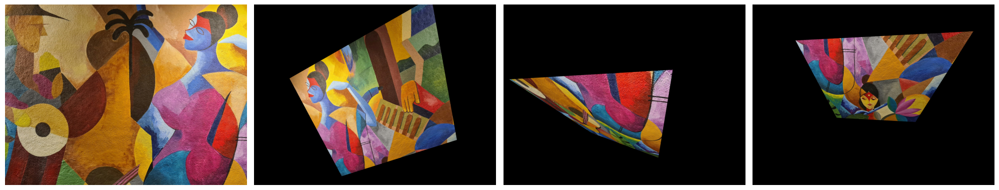


Displaying input images for I2: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


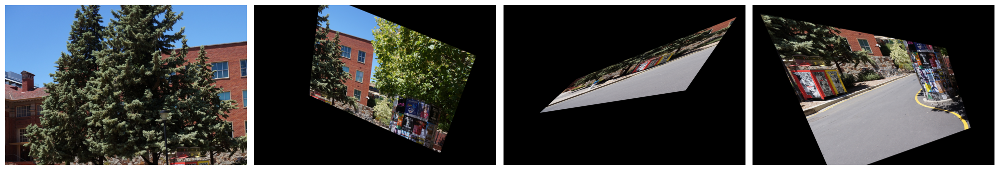


Displaying input images for I3: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


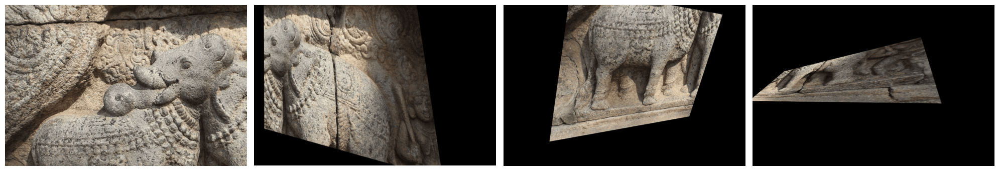


Displaying input images for I4: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


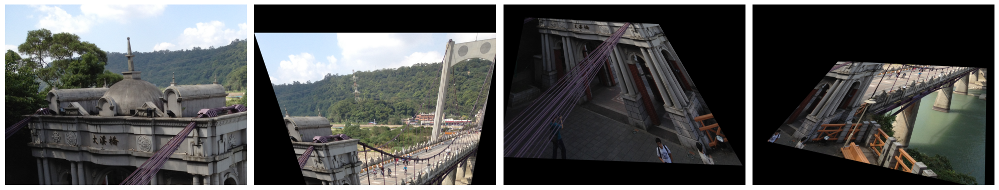


Displaying input images for I5: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


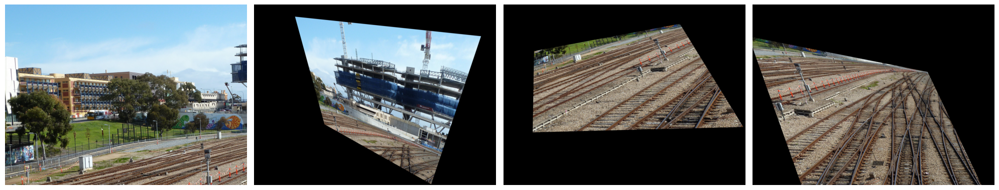

In [ ]:
## Importing recipes
%matplotlib inline

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from google.colab import drive
# Mounting google drive
drive.mount('/content/drive')

def display_images_in_row(images, cmap='gray'):
    fig, axs = plt.subplots(1, len(images), figsize=(5 * len(images), 5))
    if len(images) == 1:
        axs = [axs]
    for ax, img in zip(axs, images):
        ax.imshow(img, cmap=cmap)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

base_dir = "/content/drive/MyDrive/ES666CV/images/C"  # Base directory containing I1, I2, ..., I5
all_images = []  # List to store restored images

for dataset in sorted(os.listdir(base_dir)):
    dataset_path = os.path.join(base_dir, dataset)
    if not os.path.isdir(dataset_path):
        continue

    # Reference image to get output size
    ref_img_path = os.path.join(dataset_path, "ref_plane_img.png")
    ref_img = cv2.imread(ref_img_path)
    ref_img = cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB)

    # List to store restored images for this dataset
    images = [ref_img]

    # Loop through warped regions 2,3,4
    for i in range(2, 5):
        warped_img_path = os.path.join(dataset_path, f"warped_region_{i}.png")

        # Load image and homography
        warped_img = cv2.imread(warped_img_path)
        warped_img = cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB)

        # Inverse warp
        images.append(warped_img)

    # Add restored images for this dataset to the main list
    all_images.append(images)


for idx,imgs in enumerate(all_images):
  print(f"\nDisplaying input images for I{idx+1}: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3")
  display_images_in_row(imgs, cmap=None)


# Task 1: Implement Inverse Warping from scratch (4 marks)
**Instructions:**

* Implement `warpPerspective_from_scratch(img, H, output_shape)` to
warp the input image img to a new plane. **The homography H maps coordinates in the source image to the target plane**, and output_shape defines the size (height, width) of the output.

* Implement `restore_images_in_reference_plane(img, H, output_shape)` to map a warped image img back to the reference plane using the inverse of H. **Here, H is the homography that originally mapped the reference plane to the warped image.**


In [ ]:
def warpPerspective_from_scratch(img, H, output_shape):
    """
    Inverse warp an image using a given homography matrix H.

    Parameters:
    img : np.array
        Input image to be warped.
    H : np.array
        Homography matrix mapping source -> target plane.
    output_shape : tuple
        (height, width) of the target image.

    Returns:
    restored : np.array
        The warped image of shape output_shape.
    """
    h, w = output_shape
    restored = np.zeros((h, w, img.shape[2]), dtype=img.dtype)

    ## TODO: Implement pixel-by-pixel forward mapping using H
    ## Hint: For each pixel in source image, compute its destination in the output plane.

    # [x', y', w']T = H [x, y, 1]T
    ## x' =  h11x + h12y + h13
    ## y' =  h11x + h12y + h13
    ## w' =  h11x + h12y + h13

    ## Forward warping ##
    # 1. we have unwarped image i.e. x, y, 1 and H. We have to warp it i.e find  x', y', w'. So

    # for y in range(img.shape[0]): #rows
    #   for x in range(img.shape[1]): #cols
    #     warp_img = np.dot(H,np.array([x,y,1]))
    #     i= int(warp_img[0]/warp_img[2])
    #     j= int(warp_img[1]/warp_img[2])

    #     if 0<=i<w and 0<=j<h:
    #       restored[j,i,:] = img[y,x,:]

    ## Inverse warping ##
    H_inv = np.linalg.inv(H)

    # 1. we have unwarped image i.e. x, y, 1 and H. We have to warp it i.e find  x', y', w'. So (x,y) => (col,row)

    for i in range(h):  #out row
      for j in range(w):  #out col
        given_img_coordi = np.dot(H_inv, np.array([j,i,1]))
        x=int(given_img_coordi[0]/given_img_coordi[2]) #in col
        y=int(given_img_coordi[1]/given_img_coordi[2]) #in row

        if 0<=x<img.shape[1] and 0<=y<img.shape[0]:
          restored[i,j,:] = img[y,x,:]

    # Rows = vertical = y
    # Cols = horizontal = x
    # NumPy: img[y, x]
    # When using homography: [x, y, 1] = [col, row, 1] = [j, i, 1]
    return restored


def restore_images_in_reference_plane(img, H, output_shape):
    """
    Restore a warped image back to the reference plane using inverse homography.

    Parameters:
    img : np.array
        Warped image to be restored.
    H : np.array
        Homography matrix mapping reference -> warped plane.
    output_shape : tuple
        (height, width) of the reference plane.

    Returns:
    warped : np.array
        Restored image in the reference plane.
    """
    h_out, w_out = output_shape

    ## TODO: Compute H inverse: H_inv
    ## TODO: For each pixel in the output (reference) plane, compute the corresponding
    ## pixel location in the warped image using H_inv.
    H_new = np.linalg.inv(H)
    warped = warpPerspective_from_scratch(img, H_new, (h_out, w_out))

    return warped


Processing dataset: I1

Processing dataset: I2

Processing dataset: I3

Processing dataset: I4

Processing dataset: I5

Displaying restored images for I1:


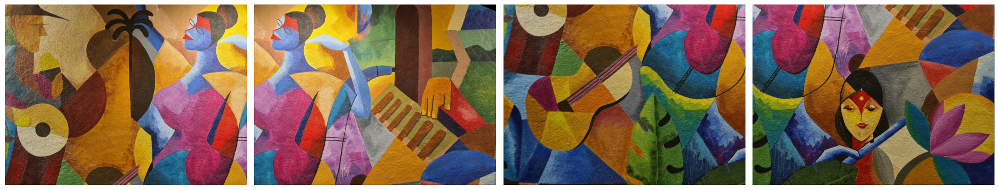


Displaying restored images for I2:


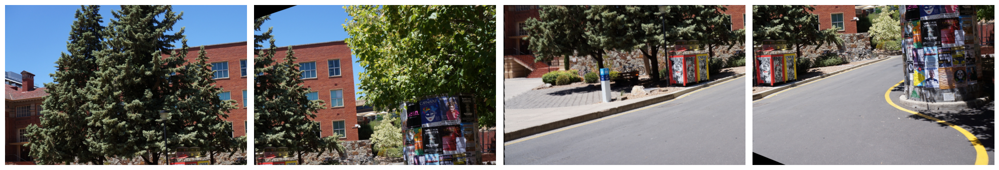


Displaying restored images for I3:


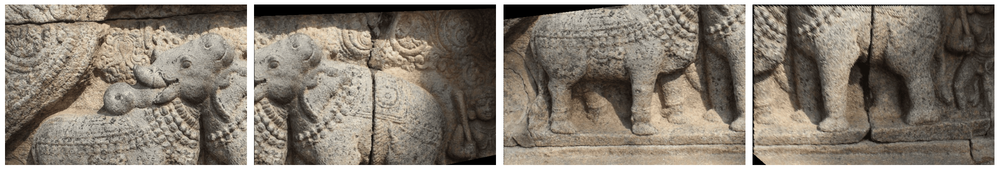


Displaying restored images for I4:


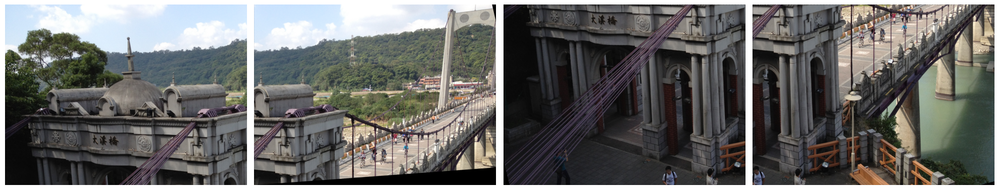


Displaying restored images for I5:


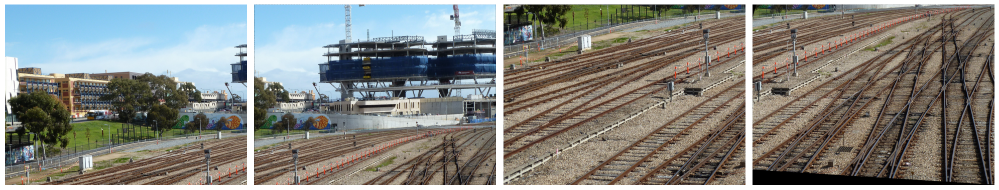

In [ ]:

restored_all = []  # List to store restored images

for dataset in sorted(os.listdir(base_dir)):
    dataset_path = os.path.join(base_dir, dataset)
    if not os.path.isdir(dataset_path):
        continue

    print(f"\nProcessing dataset: {dataset}")

    # Reference image to get output size
    ref_img_path = os.path.join(dataset_path, "ref_plane_img.png")
    ref_img = cv2.imread(ref_img_path)
    ref_img = cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB)
    h_out, w_out = ref_img.shape[:2]

    # Directory containing homography matrices
    homography_dir = os.path.join(dataset_path, "homographies")

    # List to store restored images for this dataset
    restored_dataset = [ref_img]

    # Loop through warped regions 2,3,4
    for i in range(2, 5):
        warped_img_path = os.path.join(dataset_path, f"warped_region_{i}.png")
        H_path = os.path.join(homography_dir, f"H_region_{i}.txt")

        # Load image and homography
        warped_img = cv2.imread(warped_img_path)
        warped_img = cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB)
        H = np.loadtxt(H_path)

        # Inverse warp
        restored_img = restore_images_in_reference_plane(warped_img, H, (h_out, w_out))
        restored_dataset.append(restored_img)

        # save restored image
        # output_dir = os.path.join(dataset_path, "restored")
        # os.makedirs(output_dir, exist_ok=True)
        # save_path = os.path.join(output_dir, f"restored_warped_region_{i}.png")
        # cv2.imwrite(save_path, restored_img)
        # print(f"Saved: {save_path}")

    # Add restored images for this dataset to the main list
    restored_all.append(restored_dataset)


for idx,imgs in enumerate(restored_all):
  print(f"\nDisplaying restored images for I{idx+1}:")
  display_images_in_row(imgs, cmap=None)


📖 **Theory Question:** Explain the difference between forward warping and inverse warping. Why is inverse warping generally preferred?
**Ans:**

**Forward Warping:**
- In forward warping, we loop over every pixel in input image and calculate where it should go in the output image.
- This is like pushing each pixel to its new location.
- Problem of this method is some pixels in the output may remail empty (gaps) because multiple pixels may not perfectly cover the ouput plane, which results holes or dark image.

**Inverse Warping:**
- In inverse warping we loop over every pixel in the output image and determine which pixel in the source image corresponds to it.
- This is like pulling the color from the source for each output pixel.
- Advantage of this is every pixel in the output is assigned a value so there are no gaps, it produces smoothter and more accurate results.

**Why inverse warping is preferred:**
- It guarantees that all pixels in the output image are filled with some color.
- It produces smoother and cleaner images.
- Simple to implement, and works well.


# Task 2: Keypoint Detection and Homography Estimation (4 marks)
**Instructions:**

* Detect keypoints and compute descriptors for each image using SIFT. Then, match keypoints between each restored region and the reference image. **You may use OpenCV functions for both detecting SIFT keypoints and matching descriptors.**

* Implement homography estimation using RANSAC from scratch. Do not use OpenCV’s findHomography for this step. Compute the homography matrix that aligns each region to the reference plane.

In [ ]:
def detect_keypoints_sift(img):
    """
    Detect keypoints and compute descriptors using SIFT.

    Parameters:
    img : np.array
        Input image in which keypoints are to be detected.

    Returns:
    keypoints : list
        Detected keypoints in the image.
    descriptors : np.array
        Feature descriptors corresponding to the keypoints.
    """
    ## TODO: Convert image to grayscale
    ## TODO: Detect SIFT keypoints
    ## TODO: Compute descriptors for the keypoints

    # 1. Converting image to the grayscale
    gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # 2. Computing keypoints and descriptors (Ref = https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html)
    sift = cv2.SIFT_create()

    keypoints, descriptors = sift.detectAndCompute(gray_img, None)
    # keypoints will be list of objects like 1. type:type(keypoints[i]), coordinates, size, angle, response, octave
    # descriptors are numpy array of shape (num_keypoints, 128) for SIFT
    # # Looking at the first keypoint
    # kp0 = keypoints[0]
    # print("Type:", type(kp0))             #==>Type: <class 'cv2.KeyPoint'>
    # print("Coordinates (x, y):", kp0.pt)  #==>Coordinates (x, y): (2.2916431427001953, 1273.9180908203125)
    # print("Size:", kp0.size)              #==>Size: 2.697762966156006
    # print("Angle:", kp0.angle)            #==>Angle: 82.06214904785156
    # print("Response:", kp0.response)      #==>Response: 0.032241325825452805
    # print("Octave:", kp0.octave)          #==>Octave: 12714751
    # print("Descriptors shape:", descriptors.shape)   #==>Descriptors shape: (106898, 128)
    return keypoints, descriptors


In [ ]:
def match_keypoints(des1, des2, ratio_thresh=0.75):
    """
    Match descriptors between two images using nearest neighbor and ratio test.

    Parameters:
    des1 : np.array
        Descriptors from the first image.
    des2 : np.array
        Descriptors from the second image.
    ratio_thresh : float
        Ratio threshold for filtering ambiguous matches.

    Returns:
    good_matches : list
        List of filtered good matches passing the ratio test.
    """
    ## TODO: Match descriptors using nearest neighbor (Using OpenCV)
    ## TODO: Apply ratio test to filter matches

    # 1. I am implementing Brute Force matching to match discriptors from openCV (https://docs.opencv.org/4.x/dc/dc3/tutorial_py_matcher.html)
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2) # knnMatch is for k nearest match

    # 2. Applying ratio test
    good_matches = []
    for m, n in matches:
        ## Here m is best match and n is second best match
        ## m.distance is distance between best match descriptors, respectively for n it is distance between 2nd best descriptors
        if m.distance < ratio_thresh * n.distance:
            good_matches.append(m)

    return good_matches

# _, des1= detect_keypoints_sift(restored_all[0][0])
# _, des2= detect_keypoints_sift(restored_all[0][1])

# matches = match_keypoints(des1, des2)
# print("type of matches",type(matches))   #==>type of matches <class 'list'>
# m = matches[0]
# print("Type:", type(m))                  #==>Type: <class 'cv2.DMatch'>
# print("queryIdx:", m.queryIdx)           #==>queryIdx: 5
# print("trainIdx:", m.trainIdx)           #==>trainIdx: 373
# print("imgIdx:", m.imgIdx)                 #==>imgIdx: 0
# print("distance:", m.distance)             #==>distance: 205.9004669189453



In [ ]:
def compute_homography_ransac(kp1, kp2, matches, iterations=1000, threshold=5):
    """
    Compute homography using matched keypoints and RANSAC.

    Parameters:
    kp1 : list
        Keypoints from the first image.
    kp2 : list
        Keypoints from the second image.
    matches : list
        Matches between keypoints of the two images.
    iterations : int
        Number of RANSAC iterations.
    threshold : float
        Distance threshold to classify inliers.

    Returns:
    H : np.array
        Estimated homography matrix mapping kp1 -> kp2.
    """
    ## TODO: Implement RANSAC to find the best homography
    ## TODO: Convert keypoints to coordinates
    ## TODO: Iteratively estimate H and count inliers
    # src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    # dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    # H, _= cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, threshold)
    H= np.zeros((3,3))
    max_inliers = 0

    ## 1. Starting with loop which has iterations so RANSAC will implemented for iterations times
    for i in range(iterations):
        ## 2. Selecting the 4 random matches
        index = np.random.choice(len(matches), 4, replace=False) # replace is false because we don't want repeated index/matches

        ## 3. Extracting pairs from the matched keypoints
        # DMatch.distance - Distance between descriptors. The lower, the better it is.
        # DMatch.trainIdx - Index of the descriptor in train descriptors
        # DMatch.queryIdx - Index of the descriptor in query descriptors
        # DMatch.imgIdx - Index of the train image.

        ### 3a. Extracting matched indices
        query_idx = [matches[idx].queryIdx for idx in index]
        train_idx = [matches[idx].trainIdx for idx in index]

        ### 3b. converting it to the coordinate pairs (x,y) and (x',y')
        pts1 = np.array([kp1[i].pt for i in query_idx])
        pts2 = np.array([kp2[i].pt for i in train_idx])

        ### 3c. converting coordinates to homogeneous coordinates (x, y, 1) and (x', y', 1).
        X1_list = np.array([(x, y, 1) for (x, y) in pts1])
        X2_list = np.array([(x, y, 1) for (x, y) in pts2])

        ### 3d. Now we know that A(8*9).h(9*1)=0(8*1). Also, A_i(2*9) so making A_i
        A=[]
        for i in range(0, 4):
            x, y, w = X1_list[i]
            x_prime, y_prime, w_prime = X2_list[i]
            # here w and w_prime is 1
            A.append([-x, -y, -1, 0, 0, 0, x_prime*x, x_prime*y, x_prime])
            A.append([0, 0, 0, -x, -y, -1, y_prime*x, y_prime*y, y_prime])

        ### 3e. We have to get h which is last column of Vt. So, Solving with SVD
        A=np.array(A)
        U, S, Vt = np.linalg.svd(A)
        H_curr= np.reshape(Vt[-1],(3,3))
        H_curr = (1 / H_curr[2,2]) * H_curr  # normalising

        ## 4. Calculate euclidean distance for each correspondence
        inliers=[]
        for m in matches:
            ### 4a. original point in the image 1 is
            x, y = kp1[m.queryIdx].pt
            X = np.array([x,y,1])

            ### 4b. corresponding point in image 2 which is matched is
            x_p, y_p = kp2[m.trainIdx].pt

            ### 4c. Now projecting image using H
            X_proj = np.dot(H_curr, np.transpose(X))
            x_proj = X_proj[0]/X_proj[2]
            y_proj = X_proj[1]/X_proj[2]

            ### 4d. Now computing euclidean distance
            d = np.sqrt((x_p - x_proj)**2 + (y_p - y_proj)**2)

            ## 5. Compute number of inliers consistent with H such that d<threshold
            if d<threshold:
                inliers.append(m)

        ## 6. Compute H with largest number of inliers
        if len(inliers) > max_inliers:
            max_inliers = len(inliers)
            H=H_curr

    return H


Processing dataset 1
Dataset 1, Region 2 Homography:
 [[ 9.95075169e-01  6.87707487e-04  1.61283066e+03]
 [-1.02463030e-03  1.00021336e+00 -4.23153714e-01]
 [-2.05212001e-06  2.10683936e-07  1.00000000e+00]]


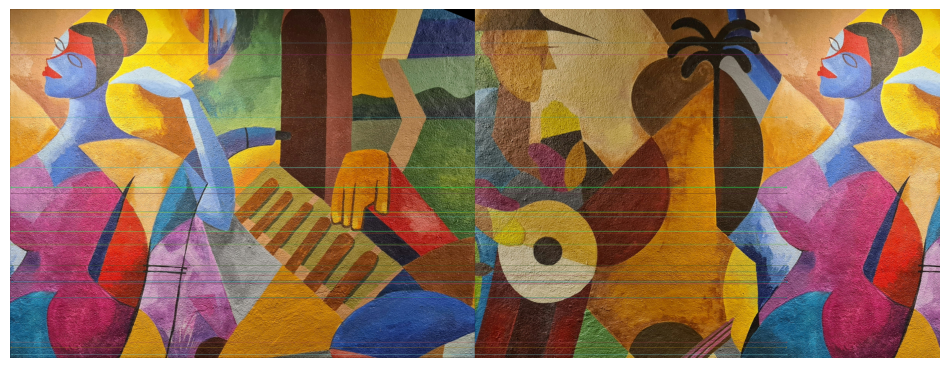

Dataset 1, Region 3 Homography:
 [[ 1.00020885e+00  2.81873949e-04  1.74012919e+00]
 [ 1.09761711e-03  9.98506581e-01  1.20912751e+03]
 [ 8.61813389e-07 -5.57992102e-07  1.00000000e+00]]


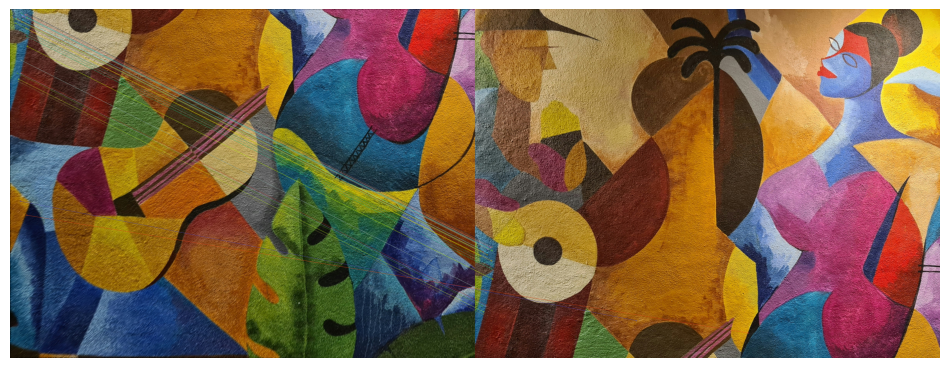

Dataset 1, Region 4 Homography:
 [[ 1.02563252e+00 -1.58214882e-02  1.61214435e+03]
 [ 1.53406727e-02  9.91947612e-01  1.20920352e+03]
 [ 1.11111496e-05 -7.13841811e-06  1.00000000e+00]]


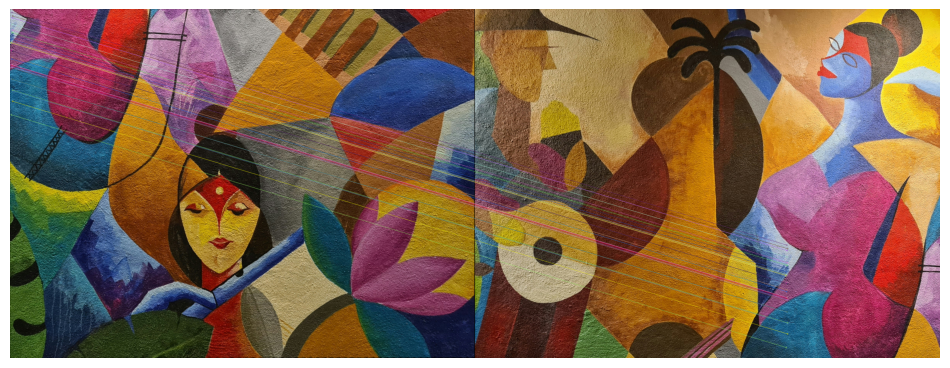


Processing dataset 2
Dataset 2, Region 2 Homography:
 [[ 1.00549478e+00  5.57137864e-03  7.99143247e+02]
 [-3.54804878e-04  1.00699059e+00 -1.75168882e+00]
 [ 6.25745185e-06  5.50794172e-06  1.00000000e+00]]


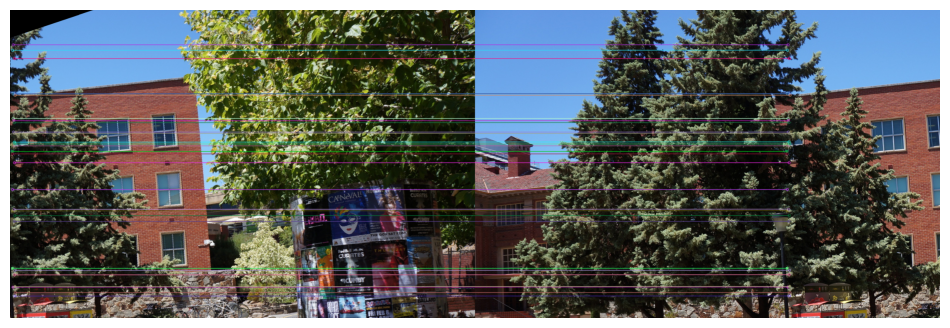

Dataset 2, Region 3 Homography:
 [[ 1.01366657e+00  6.33548829e-03 -5.91415406e+00]
 [ 7.65766164e-03  1.01093962e+00  5.27523764e+02]
 [ 7.10582375e-06  1.21027015e-05  1.00000000e+00]]


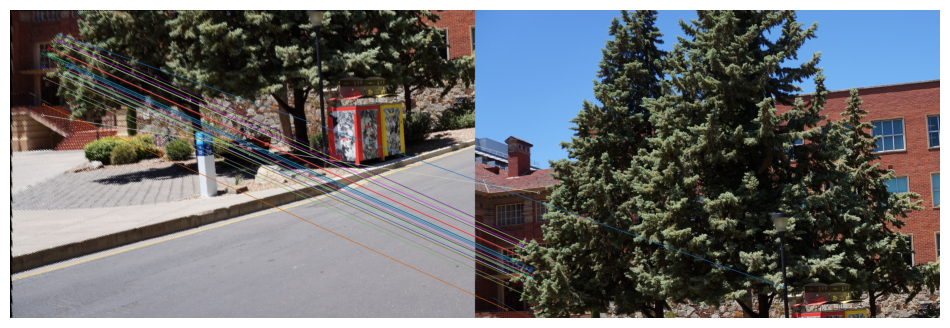

Dataset 2, Region 4 Homography:
 [[ 9.38184355e-01  9.15151965e-02  7.98409061e+02]
 [-4.09958312e-02  1.05286389e+00  5.32517826e+02]
 [-6.42895567e-05  9.18110789e-05  1.00000000e+00]]


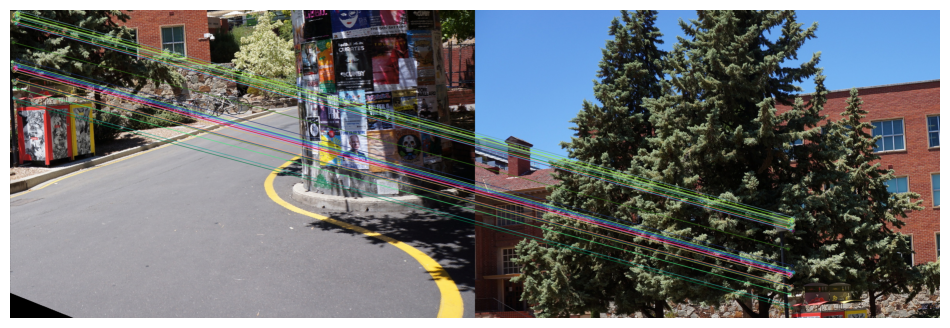


Processing dataset 3
Dataset 3, Region 2 Homography:
 [[ 9.81448929e-01  1.80691142e-02  4.09100395e+02]
 [-7.48667999e-03  1.00961005e+00 -9.32485453e-01]
 [-4.79869427e-05  3.66218961e-05  1.00000000e+00]]


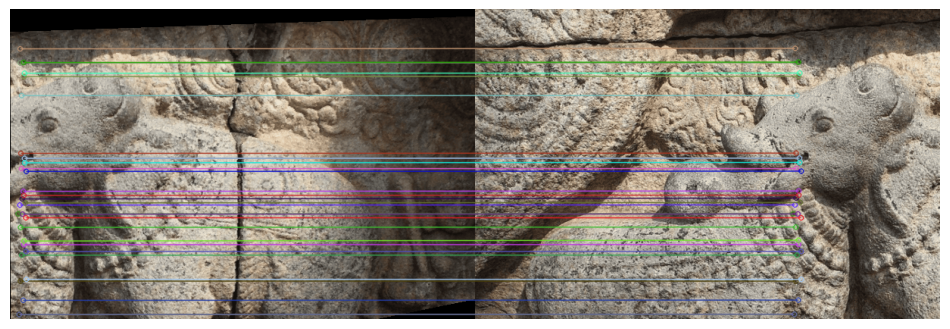

Dataset 3, Region 3 Homography:
 [[ 1.00499653e+00  3.38273836e-02 -3.41520520e+00]
 [ 1.90507368e-03  1.04868696e+00  2.69670435e+02]
 [-3.92527168e-08  7.08031636e-05  1.00000000e+00]]


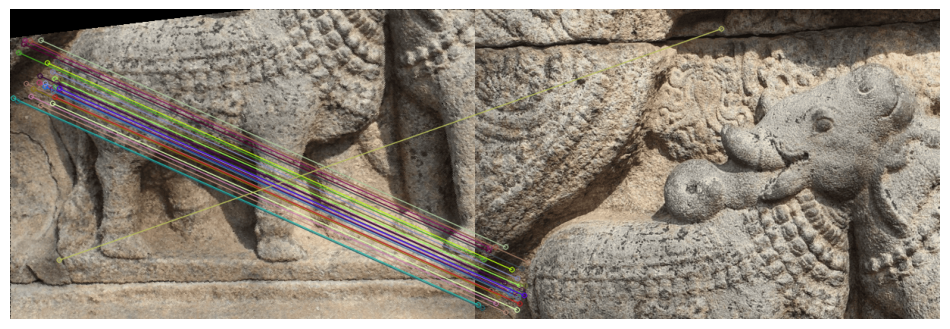

Dataset 3, Region 4 Homography:
 [[ 1.03304142e+00  2.22839614e-01  4.03292796e+02]
 [ 3.56598598e-03  1.16399370e+00  2.67962868e+02]
 [-1.45625804e-06  4.21536397e-04  1.00000000e+00]]


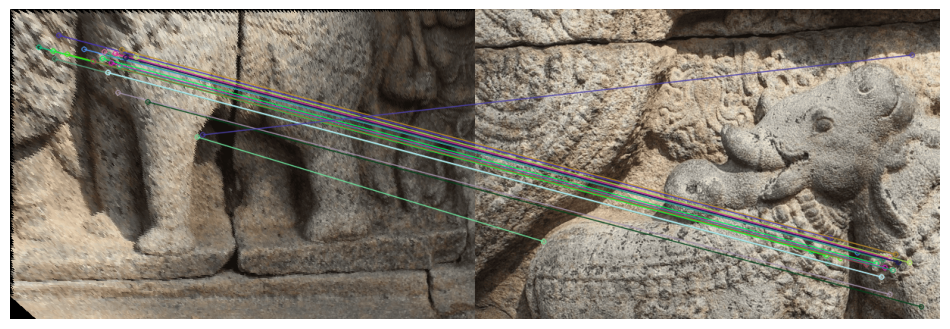


Processing dataset 4
Dataset 4, Region 2 Homography:
 [[ 9.86566971e-01 -2.39757400e-03  1.30464652e+03]
 [-5.26672906e-03  9.93075996e-01  3.84443090e+00]
 [-6.13214214e-06 -2.74423631e-06  1.00000000e+00]]


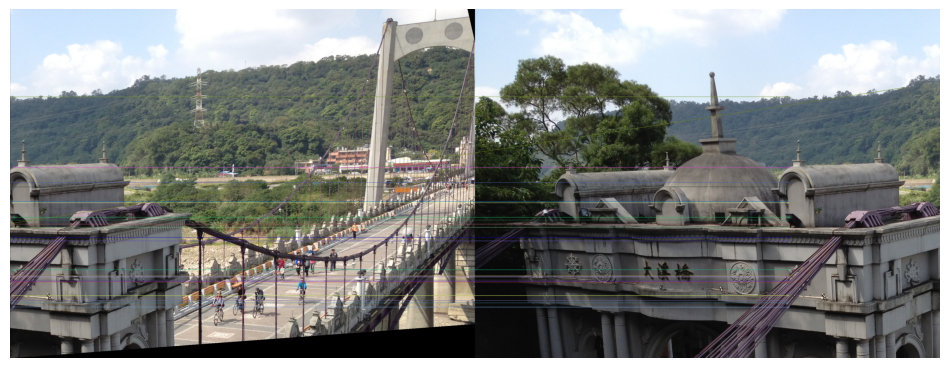

Dataset 4, Region 3 Homography:
 [[ 1.00196882e+00  2.21189535e-03 -1.65535730e+00]
 [-5.18047557e-04  1.00703690e+00  9.79033326e+02]
 [-7.13546150e-07  4.84947580e-06  1.00000000e+00]]


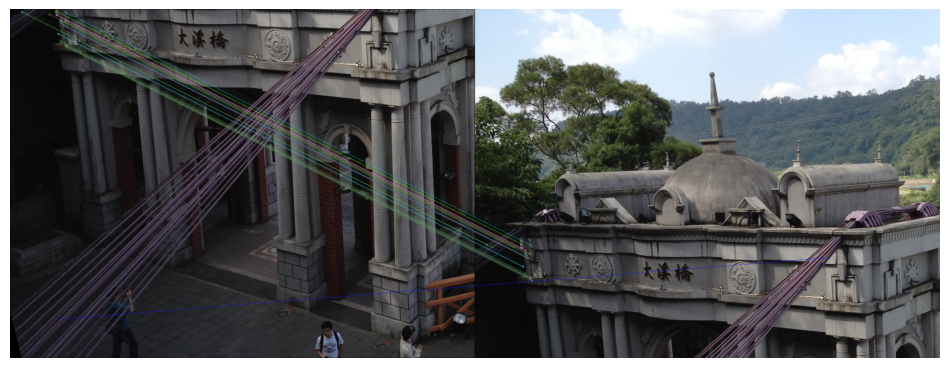

Dataset 4, Region 4 Homography:
 [[ 9.96957928e-01 -2.22319893e-02  1.30622105e+03]
 [ 1.17214326e-04  9.81888834e-01  9.79378631e+02]
 [ 2.19572933e-07 -1.33190555e-05  1.00000000e+00]]


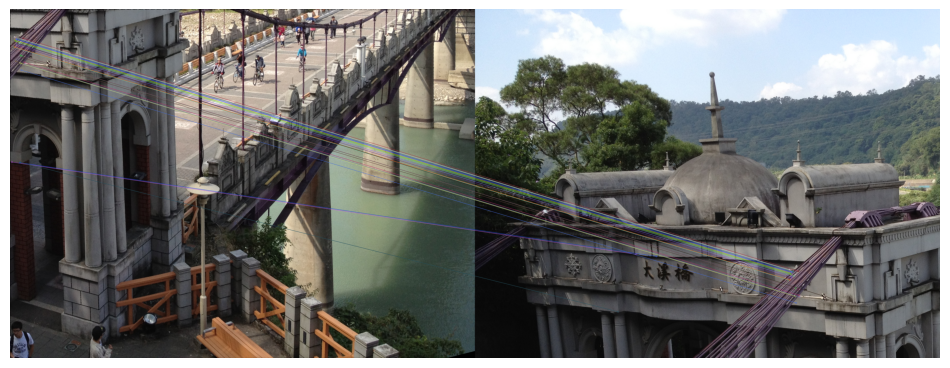


Processing dataset 5
Dataset 5, Region 2 Homography:
 [[ 1.01831271e+00  3.77233948e-04  7.98189325e+02]
 [ 4.72672545e-03  1.00237369e+00 -1.70213674e+00]
 [ 1.18800622e-05 -3.93228262e-07  1.00000000e+00]]


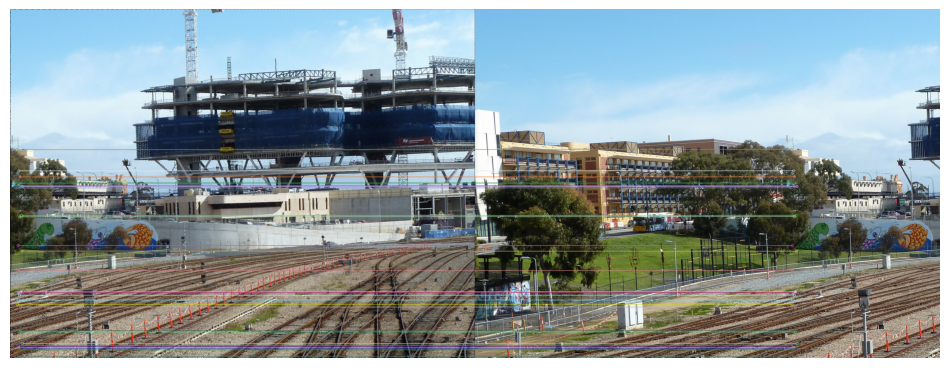

Dataset 5, Region 3 Homography:
 [[ 9.96688839e-01  8.38161490e-03 -1.57786225e+00]
 [-2.47139588e-03  1.00487087e+00  5.98829576e+02]
 [-3.25001133e-06  6.22165792e-06  1.00000000e+00]]


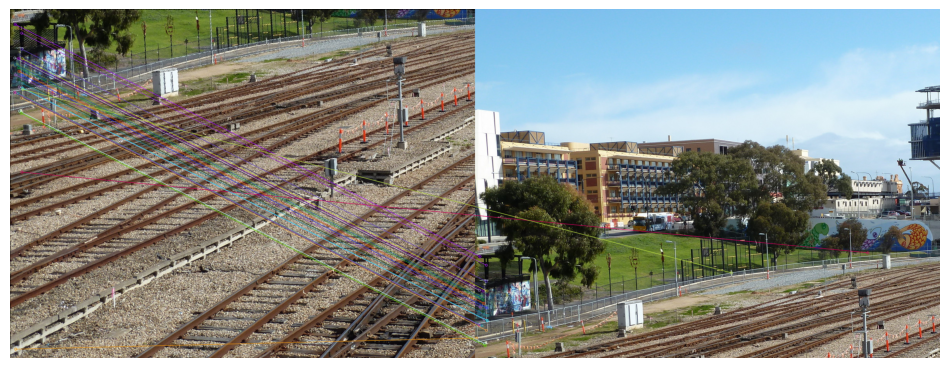

Dataset 5, Region 4 Homography:
 [[1.02938863e+00 2.47652114e-02 7.96963154e+02]
 [7.93349625e-03 1.02766436e+00 5.99074913e+02]
 [1.53071241e-05 2.42968106e-05 1.00000000e+00]]


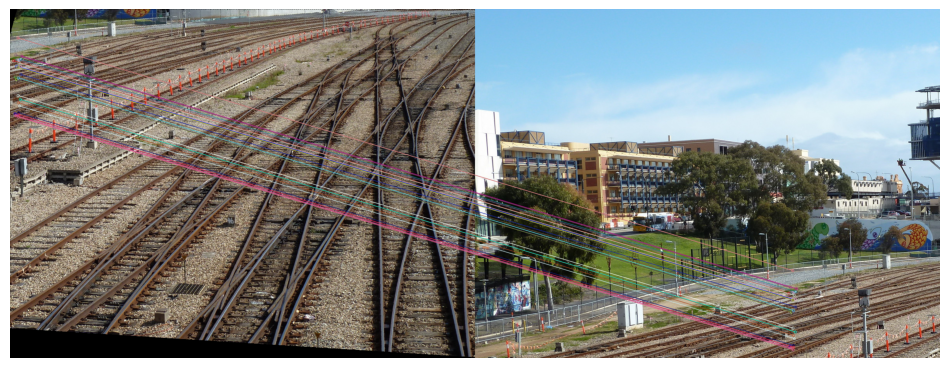

In [ ]:
homographies_all = []  # nested list: [dataset][region_index] -> H

for dataset_idx, dataset_images in enumerate(restored_all):
    print(f"\nProcessing dataset {dataset_idx+1}")
    homographies_dataset = []

    # Use the reference image as base (assume region_1 is at index 0)
    ref_img = dataset_images[0]
    kp_ref, des_ref = detect_keypoints_sift(ref_img)

    # Compute homography for each of the other restored regions
    for region_idx in range(1, len(dataset_images)):
        img = dataset_images[region_idx]
        kp, des = detect_keypoints_sift(img)

        matches = match_keypoints(des, des_ref)


        H = compute_homography_ransac(kp, kp_ref, matches)
        homographies_dataset.append(H)

        print(f"Dataset {dataset_idx+1}, Region {region_idx+1} Homography:\n", H)

        # visualize matches
        img_matches = cv2.drawMatches(img, kp, ref_img, kp_ref, matches[:30], None, flags=2)
        plt.figure(figsize=(12,6))
        plt.imshow(img_matches)
        plt.axis('off')
        plt.show()

    homographies_all.append(homographies_dataset)

📖 **Theory Question:** What could happen if you compute a homography using all matched points without handling outliers? Give an example.

**Ans:**

When we are using feature detectors then it will find matching points between two images. But all matching points are not correct, some points match incorrectly because of texture similarity, repeated patterns or lightning changes etc. These incorrect correspondences are called the outliers.

If we compute the homography using all matches (including inliers and outliers) then the resulting transformation the homography matrix will becomes distorted. This is because false match pull the transformation in wrong direction. Least square fitting tries to satisfy all points including wrong one which leads to wrong transformation matrix. Hence, the geometric relation between the two views becomes meaningless. The projected image will appear distorted, misaligned, or warped incorrectly. Straight lines may curve, and overlapping regions may not align properly.

Example -
If we take two photos of football field. Most of the features we detect will be white lines on the field. But few matches accidently link compund of field with the goalpost or dustbin in one image. If we compute the homography using all matched points then the homography will try to satisfy both the correct field lines and the wrong matches (goalpost or dustbin). As a result:

- The transformation can become distorted, skewing the field.
- Lines might not align properly between the images.
- Objects like the goalpost or dustbin may appear misplaced or floating in the stitched image.


# Task 3: Stitch the Images to Form the Original Image (2 Marks)

* Complete the function `stitch_with_known_homographies(base_img, other_imgs, homographies)` to stitch all regions into the original reference plane.
* **Use your implementation of `warpPerspective_from_scratch()` to warp each region into the base image plane.**
* **Ensure the base image (ref_plane_img.png) remains unaltered and all warped regions are aligned correctly using the homographies you have calculated in the preevious step.**
* Return the final stitched image with the same dimensions as the base image.

In [ ]:
def stitch_with_known_homographies(base_img, other_imgs, homographies):
    """
    Stitch multiple image regions into the plane of a base image using known homographies.

    Parameters:
    base_img : np.array
        Reference image (Region 1) that serves as the base plane.
    other_imgs : list of np.array
        Restored regions (e.g., Regions 2, 3, 4) to be stitched.
    homographies : list of np.array
        Homography matrices mapping each region to the base image plane.

    Returns:
    stitched_image : np.array
        The final stitched image containing all regions aligned to the base plane.
    """
    ## TODO: Determine the canvas size for stitching
    ## TODO: Place the base image in the canvas
    ## TODO: Translate homographies to canvas coordinates if needed
    ## TODO: Warp each region using your warpPerspective implementation
    ## TODO: Merge warped regions onto the canvas (e.g., simple overwrite or blending)

    ## 1. getting the base image dimensions for the canvas
    bh, bw = base_img.shape[:2]

    ## 2. Creating corner coordinates for base image (x, y, 1)
    base_corners = np.array([[0, 0, 1],[bw, 0, 1],[bw, bh, 1],[0, bh, 1]], dtype=np.float32)
    ## 3. Collecting all corners (base + transformed others)
    all_points = [base_corners[:, :2]]

    for img, H in zip(other_imgs, homographies):
        # skipping invalid homography
        if H is None or not isinstance(H, np.ndarray) or H.shape != (3, 3):
            print("[DEBUG] Skipping invalid homography:", H)
            continue

        ih, iw = img.shape[:2]

        # corners of the current image
        img_corners = np.array([[0, 0, 1],[iw, 0, 1],[iw, ih, 1],[0, ih, 1]], dtype=np.float32)

        # transforming corners using H
        transformed = (H @ img_corners.T).T
        transformed = transformed / transformed[:, [2]]  # normalizing by w
        all_points.append(transformed[:, :2])

    ## 4. Stacking all corner points
    all_points = np.vstack(all_points)

    ## 5. Getting min and max coordinates for overall bounding box
    min_xy = np.floor(all_points.min(axis=0)).astype(int)
    max_xy = np.ceil(all_points.max(axis=0)).astype(int)

    ## 6. Computing translation to check all points are in positive range
    shift_x = -min_xy[0]
    shift_y = -min_xy[1]
    T = np.array([[1, 0, shift_x],[0, 1, shift_y],[0, 0, 1]], dtype=np.float32)

    canvas_w = int(max_xy[0] - min_xy[0])
    canvas_h = int(max_xy[1] - min_xy[1])

    ## 7. Warping base image with translation matrix and placing it in canvas
    canvas = warpPerspective_from_scratch(base_img, T, (canvas_h, canvas_w))

    ## 8. ziping images and homographies to pass into our initial function to do warping
    for img, H in zip(other_imgs, homographies):
        # skipping H if it is wrong or empty
        if H is None or not isinstance(H, np.ndarray) or H.shape != (3, 3):
            print("[DEBUG] Skipping invalid homography:", H)
            continue

        ## 9 Applying combined transformation (translation + homography)
        H_total = T @ H
        warped = warpPerspective_from_scratch(img, H_total, (canvas_h, canvas_w))

        ## 4. Now if warped image has pixel colors then we are going to replace(mask) pixel of base image.
        mask = np.any(warped > 0, axis=2)
        # overlap = mask & np.any(canvas > 0, axis=2)
        canvas[mask] = warped[mask]               # overwriting

        ### I got that if base image and warped image colors get overlap then we will use the blending and otherwise we will use overwriting
        ### where both overlap with colors
        # canvas[overlap] = 0.5 * canvas[overlap] + 0.5 * warped[overlap]    #blending
        ### where new region arrives
        # only_warp = mask & (~np.any(canvas > 0, axis=2))
        # canvas[only_warp] = warped[only_warp]

    stitched_image = canvas
    return stitched_image



[INFO] Processing dataset 1
[INFO] Saved stitched result: stitched_results/stitched_dataset_1.png


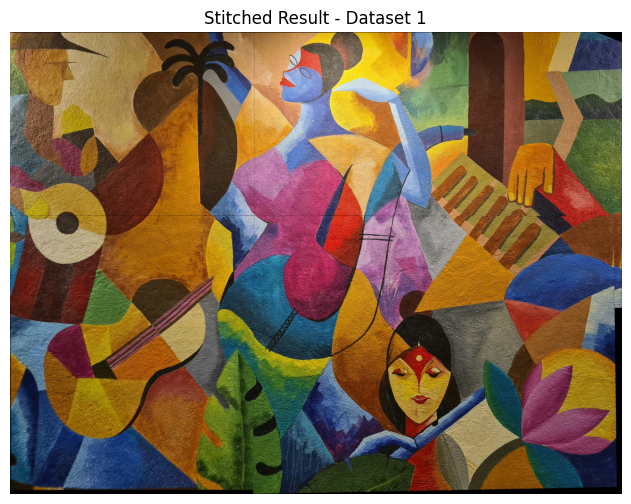


[INFO] Processing dataset 2
[INFO] Saved stitched result: stitched_results/stitched_dataset_2.png


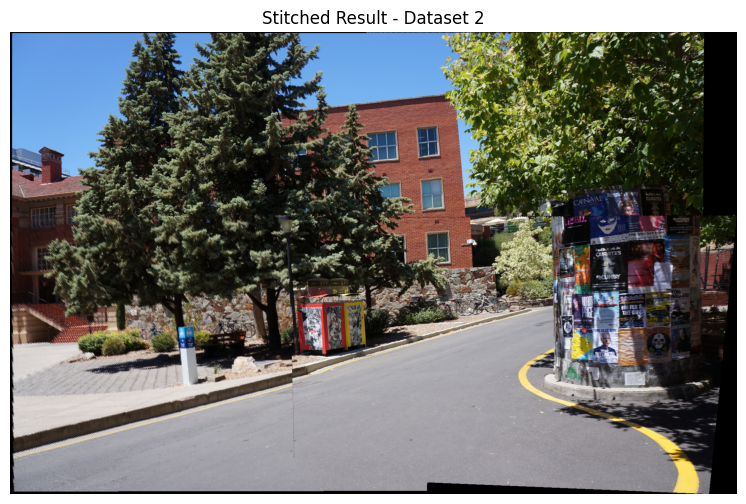


[INFO] Processing dataset 3
[INFO] Saved stitched result: stitched_results/stitched_dataset_3.png


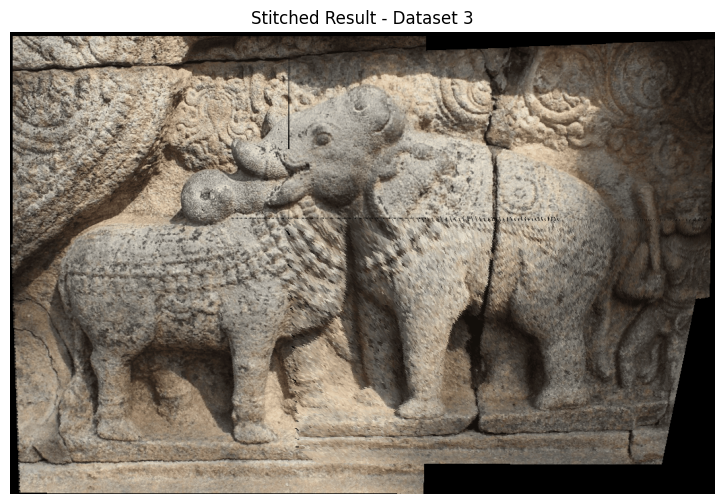


[INFO] Processing dataset 4
[INFO] Saved stitched result: stitched_results/stitched_dataset_4.png


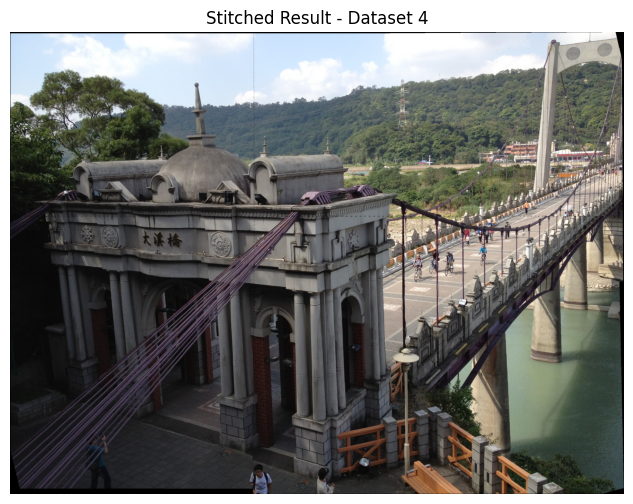


[INFO] Processing dataset 5
[INFO] Saved stitched result: stitched_results/stitched_dataset_5.png


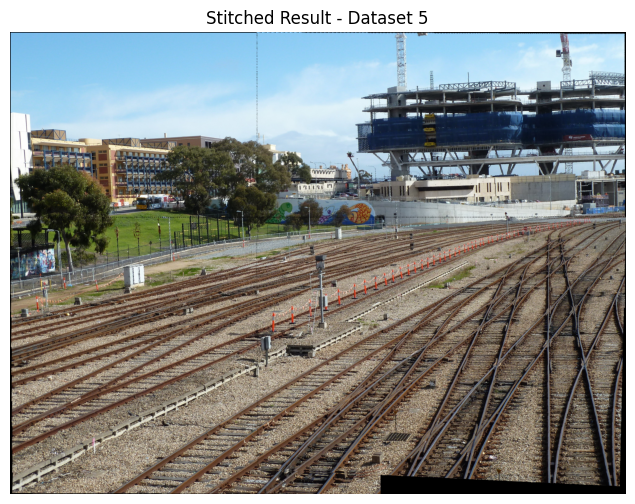

In [ ]:
# ----------------------------
# Run stitching on all datasets
# ----------------------------
stitched_all = []
output_dir = "stitched_results"
os.makedirs(output_dir, exist_ok=True)

for dataset_idx, dataset_images in enumerate(restored_all):
    print(f"\n[INFO] Processing dataset {dataset_idx+1}")

    # First image is reference (Region 1)
    ref_img = dataset_images[0]

    # Remaining images are other regions
    other_imgs = dataset_images[1:]

    # Homographies for this dataset
    homographies = homographies_all[dataset_idx]

    # Stitch
    stitched = stitch_with_known_homographies(ref_img, other_imgs, homographies)
    stitched_all.append(stitched)

    # Save
    save_path = os.path.join(output_dir, f"stitched_dataset_{dataset_idx+1}.png")
    cv2.imwrite(save_path, stitched)
    print(f"[INFO] Saved stitched result: {save_path}")

    # Show
    stitched_rgb = stitched
    plt.figure(figsize=(12,6))
    plt.imshow(stitched_rgb)
    plt.title(f"Stitched Result - Dataset {dataset_idx+1}")
    plt.axis("off")
    plt.show()

📖 **Theory Question:** Why is it important that the base image remains unaltered during stitching?

**Ans:**

If we change or distort the base image then every other refion that is aligned with base image will get misplace with breaking overall alignment. That's why it is important that the base image remains unaltered during during stitching because it acts as the reference frame for all other images.

By keeping the base image fixed we ensure that all transformations like homographies are calculated relative to a stable, original view. This helps us to preserve correct scale, and visual consistancy in the final stiched result.